<a href="https://colab.research.google.com/github/TalhaAhmed2000/DeepLearning/blob/main/Task 1/Image_Classification_CNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Importing Libaries pertaining to:

***Miscellanous***
- `numpy`
- `pandas`
- `google.colab.drive`
- `typing.Dict, typing.List, typing.Tuple`

***Pytorch***
- `torch`
- `torch.nn`
- `torchvision`

***Processing + Loading of Data***
- `torchvision.transforms`
- `torchvision.datasets`
- `torch.utils.data.Dataset`
- `torch.utils.data.DataLoader`
- `pathlib.Path`
- `requests`
- `zipfile`
- `os`
- `re`
- `random`
- `import shutil`

***Visualization/Evaluation of Model Results***
- `torchinfo.summary`
- `torch.utils.tensorboard.SummaryWriter`
- `tqdm.auto`
- `PIL.Image`
- `matplotlib.pyplot.plt`
- `timeit.default_timer`
- `torchmetrics`
- `torcheval.metrics`
- `mlxtend`

In [ ]:
# Importing Relevant Libraries

# Micellaneous
import numpy as np
import pandas as pd
from google.colab import drive
drive.mount('/content/drive')
from typing import Dict, List, Tuple
import warnings
warnings.filterwarnings("ignore")

# Pytorch Libraries
import torch
from torch import nn
import torchvision

# Processing + Loading of Data
from torchvision import transforms
from torchvision import datasets
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
import zipfile
import requests
from pathlib import Path
import os
import re
import random
import shutil

# Visualization/Evaluation of Model Results
# Try to get torchinfo, install it if it doesn't work
try:
    from torchinfo import summary
except:
    print("[INFO] Couldn't find torchinfo... installing it.")
    !pip install -q torchinfo
    from torchinfo import summary
from torch.utils.tensorboard import SummaryWriter
from timeit import default_timer as timer
from PIL import Image
from tqdm.auto import tqdm
import matplotlib.pyplot as plt

Mounted at /content/drive
[INFO] Couldn't find torchinfo... installing it.


In [ ]:
# See if torchmetrics exists, if not, install it
try:
    import torchmetrics, mlxtend, torcheval
except:
    !pip install -q torchmetrics -U mlxtend -U torcheval
    import torchmetrics, mlxtend

# Get Evaluation Metrics
from torcheval.metrics.functional import multiclass_accuracy, multiclass_precision, multiclass_recall, multiclass_f1_score

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 729.2/729.2 kB 32.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.4/158.4 kB 20.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.9/87.9 kB 11.2 MB/s eta 0:00:00


### Loading Data + Transformation into Pytorch DataLoader & Dataset


In [ ]:
!rm -rf DeepLearning

In [ ]:
# Import Formatted Data from github - refer to custom_data_creation.ipynb

# Clone github to access data
!git clone https://github.com/TalhaAhmed2000/DeepLearning.git

# Set up paths for the directories
root_data = Path('/content/DeepLearning/Task 1/Formatted Data/')

train_data_path = root_data / 'train'
test_data_path = root_data / 'test'

# Check Structure of Data
for dirpath, dirnames, filenames in os.walk(root_data):
  print(f"There are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'.")

Cloning into 'DeepLearning'...
remote: Enumerating objects: 16092, done.
remote: Counting objects: 100% (473/473), done.
remote: Compressing objects: 100% (256/256), done.
remote: Total 16092 (delta 254), reused 391 (delta 209), pack-reused 15619
Receiving objects: 100% (16092/16092), 2.27 GiB | 18.69 MiB/s, done.
Resolving deltas: 100% (520/520), done.
Updating files: 100% (25715/25715), done.
There are 2 directories and 0 images in '/content/DeepLearning/Task 1/Formatted Data'.
There are 23 directories and 0 images in '/content/DeepLearning/Task 1/Formatted Data/test'.
There are 0 directories and 34 images in '/content/DeepLearning/Task 1/Formatted Data/test/beagle'.
There are 0 directories and 34 images in '/content/DeepLearning/Task 1/Formatted Data/test/yorkshire terrier'.
There are 0 directories and 34 images in '/content/DeepLearning/Task 1/Formatted Data/test/sphynx'.
There are 0 directories and 34 images in '/content/DeepLearning/Task 1/Formatted Data/test/corgi'.
There are 0 

Approximately 35 images per breed in test and 135 for train

Random image path: /content/DeepLearning/Task 1/Formatted Data/train/ragdoll cat/ragdoll cat_21.jpg
Image class: ragdoll cat
Image height: 1024
Image width: 1536


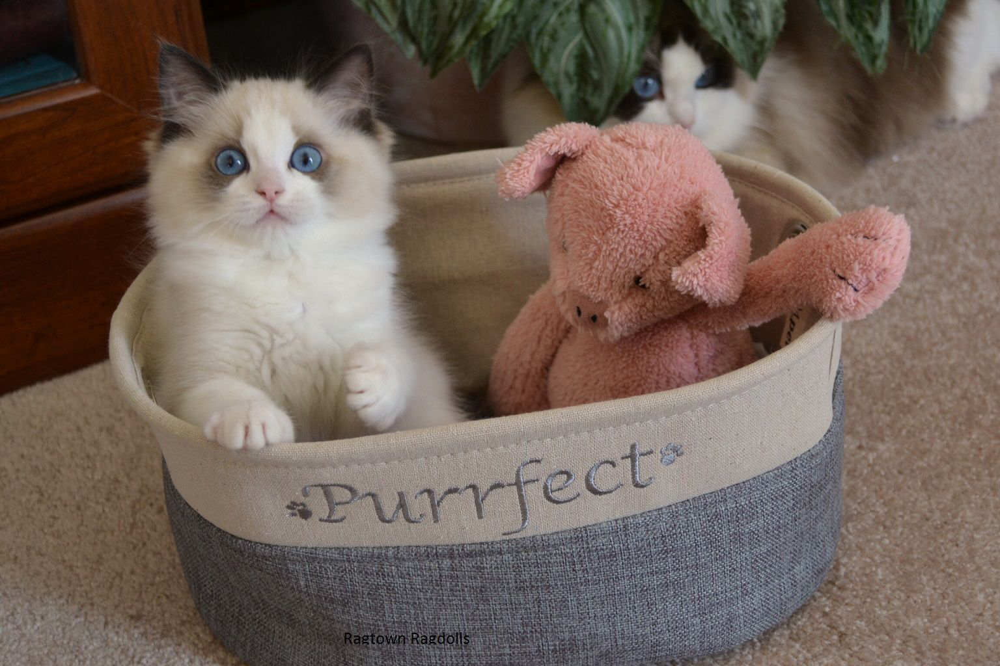

In [ ]:
# Let's Visualize an image using Image

# Set seed to ensure reproducibility
random.seed(42)

# 1. Get the list of images using glob and .jpg as reference
image_path_list = list(root_data.glob("*/*/*.jpg"))

# 2. Get random image path
random_image_path = random.choice(image_path_list)

# 3. Get image class from path name (the image class is the name of the directory where the image is stored)
image_class = random_image_path.parent.stem

# 4. Open image
img = Image.open(random_image_path)

# 5. Print characterisitcs of the image such as height, width
print(f"Random image path: {random_image_path}")
print(f"Image class: {image_class}")
print(f"Image height: {img.height}")
print(f"Image width: {img.width}")
img

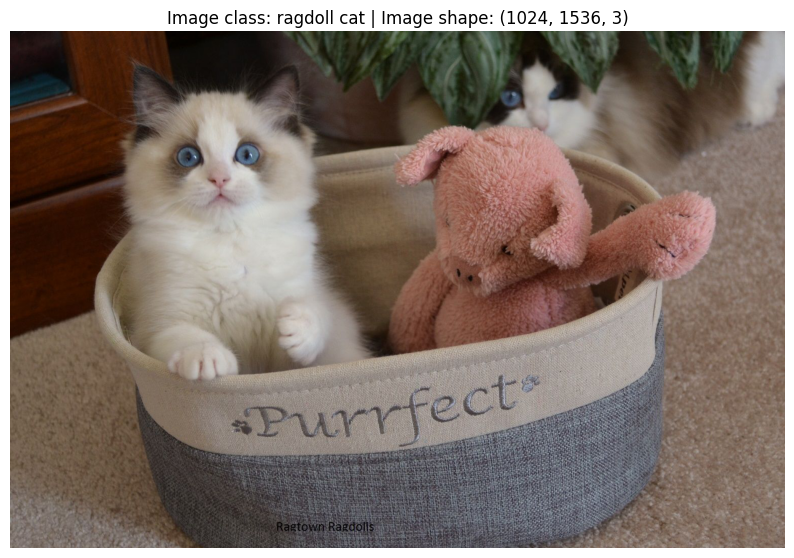

In [ ]:
# Using Numpy

# Turn the image into an numpy array
img_as_array = np.asarray(img)

# Plot the image with matplotlib
plt.figure(figsize = (10, 7))
plt.imshow(img_as_array)
plt.title(f"Image class: {image_class} | Image shape: {img_as_array.shape}")
plt.axis(False);

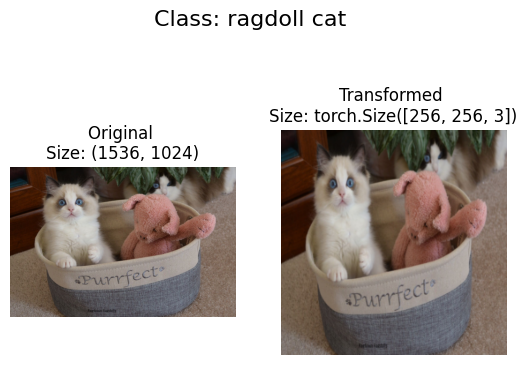

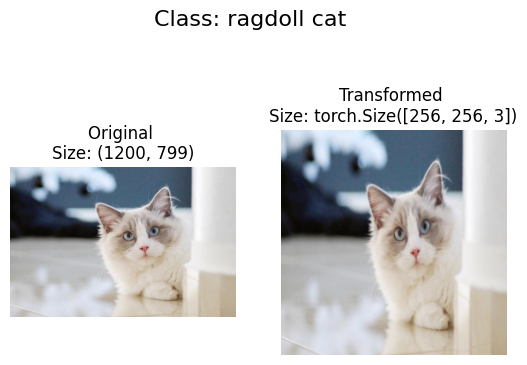

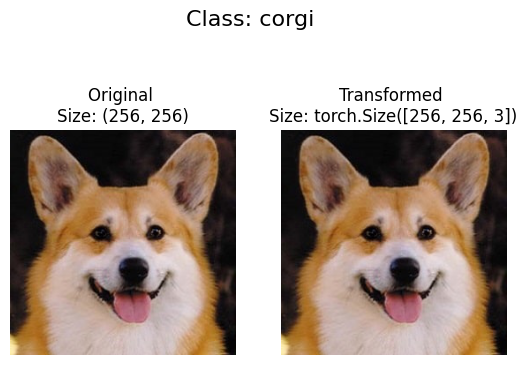

In [ ]:
# Experimenting with some data augmentation
test_transform = transforms.Compose([
    transforms.Resize(size = (256, 256)),
    transforms.ToTensor(),
])

# Making a helper function for plotting images with transforms

def plot_transformed_images(image_paths: List,
                            transform: torchvision.transforms.Compose,
                            n: int = 3,
                            seed: int = 42):
    """Plots "n" images from the list given "image_paths", transforming them if required

    Args:
        image_paths (List): List containing paths to all images
        transform (torchvision.transforms.Compose): Transforms to apply to images.
        n (int): Number of images to plot. Defaults to 3.
        seed (int): Random seed for the random sampling from the list. Defaults to 42.
    """
    # Set Seed and random sample from the list
    random.seed(seed)
    random_image_paths = random.sample(image_paths, k = n)

    # For each image, show its original shape and its shape after transform
    for image_path in random_image_paths:
        with Image.open(image_path) as f:
            fig, ax = plt.subplots(1, 2)
            ax[0].imshow(f)
            ax[0].set_title(f"Original \nSize: {f.size}")
            ax[0].axis("off")

            # Transform and plot image
            # Note: permute() done because matplotlib accepts images in the format H, W, C
            transformed_image = transform(f).permute(1, 2, 0)
            ax[1].imshow(transformed_image)
            ax[1].set_title(f"Transformed \nSize: {transformed_image.shape}")
            ax[1].axis("off")

            fig.suptitle(f"Class: {image_path.parent.stem}", fontsize=16)

# Plot three images
plot_transformed_images(image_path_list,
                        transform = test_transform,
                        n = 3)

In [ ]:
# Creating our custom dataclass for the data we have by making it inherit from torch.utils.data.Datasets. This will enable us to transform them into dataloaders which have their own benefits with
# multiple in-built modularities like data augmentation + we make them iterable hence clearly can access the target labels and the features seperately

# Creating custom dataset using torchvision.datasets.ImageFolder. Afterwards getting dataloaders for both train and test. Let's use the function in our python script from github

# Download it from GitHub
try:
  from py_scripts import get_custom_data
except:
  !mv DeepLearning/"Task 1"/python_scripts py_scripts
  from py_scripts import get_custom_data

In [ ]:
# Get Custom Dataset and Dataloaders for both train and test

train_data, test_data, train_dataloader, test_dataloader = get_custom_data.getImageFolderDataLoaders(train_dir = train_data_path,
                                                                                                     test_dir = test_data_path,
                                                                                                     transform = test_transform,
                                                                                                     batch = 32)

In [ ]:
# Get Classes as a list
class_names = train_data.classes
# Get dictionary of classes and their index
class_dict = train_data.class_to_idx

In [ ]:
# Device Agnostic Code
device = 'cuda' if torch.cuda.is_available else 'cpu'

In [ ]:

# BaseLine Model - CNN

class AnimalBreedClassifierV0(nn.Module):
  def __init__(self, input_shape: int, hidden_units: int, output_shape: int):
    super().__init__()
    self.block_1 = nn.Sequential(
        nn.Conv2d(in_channels = input_shape,
                  out_channels = hidden_units,
                  kernel_size = 3,
                  stride = 2,
                  padding = 1),
        nn.ReLU(),
        nn.MaxPool2d(kernel_size = 4,
                     stride = 4)
    )
    self.block_2 = nn.Sequential(
        nn.Conv2d(in_channels = hidden_units,
                  out_channels = hidden_units,
                  kernel_size = 3,
                  stride = 2,
                  padding = 1),
        nn.ReLU(),
        nn.MaxPool2d(kernel_size = 4,
                     stride = 4)
    )
    self.fc_layer = nn.Sequential(
        nn.Flatten(),
        nn.Linear(in_features = hidden_units * 4 * 4,
                  out_features = output_shape)
    )

  def forward(self, x: torch.Tensor): # x of the dim -> [batch_size, channels, height, width]
    x = self.block_1(x)
    # print(f'block 1 ouptut shape {x.shape}') # --> [batch_size, out_channels, height/2, width/2]

    x = self.block_2(x)
    # print(f'block 2 ouptut shape {x.shape}') # -->  [batch_size, out_channels, height/4, width/4]

    x = self.fc_layer(x)
    # print(f'fc layer ouptut shape {x.shape}') # --> [batch_size, len(class_names)]

    return x

torch.manual_seed(42)
model_0 = AnimalBreedClassifierV0(input_shape = 3,
                                hidden_units = 10,
                                output_shape = len(class_names)).to(device)
model_0

AnimalBreedClassifierV0(
  (block_1): Sequential(
    (0): Conv2d(3, 10, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): ReLU()
    (2): MaxPool2d(kernel_size=4, stride=4, padding=0, dilation=1, ceil_mode=False)
  )
  (block_2): Sequential(
    (0): Conv2d(10, 10, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): ReLU()
    (2): MaxPool2d(kernel_size=4, stride=4, padding=0, dilation=1, ceil_mode=False)
  )
  (fc_layer): Sequential(
    (0): Flatten(start_dim=1, end_dim=-1)
    (1): Linear(in_features=160, out_features=23, bias=True)
  )
)

In [ ]:
# Summary of model
summary(model_0, input_size = (32, 3, 256, 256))

Layer (type:depth-idx)                   Output Shape              Param #
AnimalBreedClassifierV0                  [32, 23]                  --
├─Sequential: 1-1                        [32, 10, 32, 32]          --
│    └─Conv2d: 2-1                       [32, 10, 128, 128]        280
│    └─ReLU: 2-2                         [32, 10, 128, 128]        --
│    └─MaxPool2d: 2-3                    [32, 10, 32, 32]          --
├─Sequential: 1-2                        [32, 10, 4, 4]            --
│    └─Conv2d: 2-4                       [32, 10, 16, 16]          910
│    └─ReLU: 2-5                         [32, 10, 16, 16]          --
│    └─MaxPool2d: 2-6                    [32, 10, 4, 4]            --
├─Sequential: 1-3                        [32, 23]                  --
│    └─Flatten: 2-7                      [32, 160]                 --
│    └─Linear: 2-8                       [32, 23]                  3,703
Total params: 4,893
Trainable params: 4,893
Non-trainable params: 0
Total mult-a

In [ ]:
# Get a random image batch and pass it through each block to check output shapes

image, label = next(iter(train_dataloader))
# test_image = (image.unsqueeze(dim = 0)).to(device)

In [ ]:
print(f'test_image.shape: {image.shape}')
result = model_0.forward(image.to(device))
result, result.shape

test_image.shape: torch.Size([32, 3, 256, 256])


(tensor([[ 0.0821,  0.1025,  0.0291, -0.0224, -0.0503, -0.0407, -0.0367,  0.0958,
           0.0118, -0.0749,  0.0511, -0.0411,  0.0025, -0.0587, -0.1200, -0.0482,
          -0.0775,  0.0695,  0.0626, -0.0263, -0.0130,  0.0871,  0.0651],
         [ 0.0877,  0.1133,  0.0150, -0.0179, -0.0455, -0.0319, -0.0579,  0.0862,
           0.0267, -0.0536,  0.0474, -0.0580,  0.0213, -0.0540, -0.1305, -0.0587,
          -0.0964,  0.0852,  0.0529, -0.0272, -0.0372,  0.0957,  0.0651],
         [ 0.0545,  0.1021,  0.0166, -0.0142, -0.0489, -0.0407, -0.0454,  0.0983,
           0.0162, -0.0670,  0.0695, -0.0454,  0.0188, -0.0529, -0.1252, -0.0591,
          -0.0848,  0.0773,  0.0475, -0.0298, -0.0148,  0.0902,  0.0416],
         [ 0.0561,  0.1104,  0.0119, -0.0045, -0.0405, -0.0446, -0.0731,  0.0862,
           0.0150, -0.0708,  0.0556, -0.0327,  0.0214, -0.0464, -0.1060, -0.0570,
          -0.0879,  0.0959,  0.0503, -0.0449, -0.0235,  0.0922,  0.0434],
         [ 0.0743,  0.1088,  0.0184,  0.0011, -0

In [ ]:
# Some Helper Functions - get utils.py from github
from py_scripts import utils

# Get the whole train, test, and evaluation functionalities from engine.py script from github
from py_scripts import engine

[INFO] Cloning the repository and importing utils script...


In [ ]:
# Create a tensorboard instance using the create writer method in utils.py
writer = SummaryWriter()
writer = utils.create_writer(experiment_name = 'pet_breed_8_20_split',
                            model_name = "AnimalBreedClassifierV0",
                            extra = '5_epochs')

# Now Choose loss function, otpimizer and epochs

EPOCHS = 5
LR_rate = 1e-3

loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(params = model_0.parameters(), lr = LR_rate)

# Recall Model
model_0

[INFO] Created SummaryWriter, saving to: /content/model_runs/2023-07-15/pet_breed_8_20_split/AnimalBreedClassifierV0/5_epochs...


AnimalBreedClassifierV0(
  (block_1): Sequential(
    (0): Conv2d(3, 10, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): ReLU()
    (2): MaxPool2d(kernel_size=4, stride=4, padding=0, dilation=1, ceil_mode=False)
  )
  (block_2): Sequential(
    (0): Conv2d(10, 10, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): ReLU()
    (2): MaxPool2d(kernel_size=4, stride=4, padding=0, dilation=1, ceil_mode=False)
  )
  (fc_layer): Sequential(
    (0): Flatten(start_dim=1, end_dim=-1)
    (1): Linear(in_features=160, out_features=23, bias=True)
  )
)

In [ ]:
# Train the model
engine.train(model = model_0,
             train_dataloader = train_dataloader,
             test_dataloader = test_dataloader,
             optimizer = optimizer,
             loss_fn = loss_fn,
             num_classes = len(class_names),
             epochs = EPOCHS,
             device = device,
             writer = writer,
             inception = False)

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 3.1305 | train_acc: 0.0573 | train_precision: 0.0101 | train_recall: 0.0560 | train_f1: 0.0140 | test_loss: 3.1184 | test_acc: 0.0575 | test_acc: 0.0575 | test_precision: 0.0522 | test_recall: 0.0183 | test_f1: 0.0234 | 
Epoch: 2 | train_loss: 3.0707 | train_acc: 0.0947 | train_precision: 0.0383 | train_recall: 0.0919 | train_f1: 0.0456 | test_loss: 3.0273 | test_acc: 0.0963 | test_acc: 0.0963 | test_precision: 0.0726 | test_recall: 0.0234 | test_f1: 0.0304 | 
Epoch: 3 | train_loss: 2.9625 | train_acc: 0.1179 | train_precision: 0.0676 | train_recall: 0.1050 | train_f1: 0.0678 | test_loss: 2.9479 | test_acc: 0.1025 | test_acc: 0.1025 | test_precision: 0.0635 | test_recall: 0.0210 | test_f1: 0.0256 | 
Epoch: 4 | train_loss: 2.8689 | train_acc: 0.1466 | train_precision: 0.0955 | train_recall: 0.1313 | train_f1: 0.0943 | test_loss: 2.8913 | test_acc: 0.1419 | test_acc: 0.1419 | test_precision: 0.1012 | test_recall: 0.0253 | test_f1: 0.0334 | 
Epoch: 5 | train_loss: 2

{'train_loss': [3.1305020469980143,
  3.0706535147637437,
  2.962478839245039,
  2.8688716101892218,
  2.7942543054364393],
 'train_acc': [0.057345360824742266,
  0.09471649484536082,
  0.11791237113402062,
  0.14658505154639176,
  0.17751288659793815],
 'train_precision': [0.01014940923544819,
  0.03828600949995675,
  0.06762840204651549,
  0.0954748120919974,
  0.12113482942739098],
 'train_recall': [0.056007982815996414,
  0.09189803842981936,
  0.1050478644682468,
  0.13127814797359338,
  0.1534074816357366],
 'train_f1': [0.013957626173726062,
  0.04561250936767114,
  0.06779292177020337,
  0.09425791266559096,
  0.11823728562680637],
 'test_loss': [3.1184090042114256,
  3.0272605514526365,
  2.947907304763794,
  2.8913390016555787,
  2.8532340049743654],
 'test_acc': [0.0575, 0.09625, 0.1025, 0.14194444444444446, 0.145],
 'test_precision': [0.052238095238095236,
  0.0726284913916493,
  0.06352762052762052,
  0.10122932622932623,
  0.08795826395826398],
 'test_recall': [0.01834178

In [ ]:
# Evaluate the model
model_0_results = engine.eval_model(model = model_0,
                              data_loader = test_dataloader,
                              loss_fn = loss_fn,
                              num_classes = len(class_names),
                              device = device,
                              inception = False)
model_0_results

{'model_name': 'AnimalBreedClassifierV0',
 'model_loss': 2.853233814239502,
 'model_accuracy': 0.145,
 'model_precision': 0.08795826395826398,
 'model_recall': 0.02634859830428043,
 'model_f1': 0.0}

In [ ]:
# Save the model using utils.save_model
utils.save_model(model = model_0,
                 target_dir = 'models',
                 model_name = 'pet_breed_classifier_V0.pth')

[INFO] Saving model to: models/pet_breed_classifier_V0.pth


In [ ]:
# Making a function which performs inference on a single image and plots it along with its predicted and true class
def pred_and_plot_image(
    model: torch.nn.Module,
    data: torch.utils.data.dataset.Dataset,
    num_to_plot: int = 9,
    transform = None,
    device: torch.device = "cuda" if torch.cuda.is_available() else "cpu",
    inception = False):
    """Makes a prediction on a set target images (randomly sampled from data) with a trained model and plots the images along with their predicted and truth label. Times the time taken for inference and takes average

    Args:
        model (torch.nn.Module): trained PyTorch image classification model.
        data (dataset: torch.utils.data.dataset.Dataset): data to sample images from
        num_to_plot (int): how many images to plot. Defaults to 9
        transform (_type_, optional): transform of target image. Defaults to None.
        device (torch.device, optional): target device to compute on. Defaults to "cuda" if torch.cuda.is_available() else "cpu".

    Returns:
        Matplotlib plot of target image and model prediction as title.

    Example usage:
        pred_and_plot_image(model = model,
                            test_data,
                            num_to_plot = 4,
                            transform = torchvision.transforms.ToTensor(),
                            device = device)
    """

    # Initialize test images and test labels as a list to iterate inferenc over
    test_labels = []
    test_samples = []

    # Intialize predicted labels
    pred_labels = []

    for sample, label in random.sample(list(data), k = num_to_plot):
      test_samples.append(sample)
      label = list(class_dict.keys())[label]
      test_labels.append(label)

    # Perform inference

    model.eval()
    # start timer
    start_time = timer()
    with torch.inference_mode():
      for sample in test_samples:
        # Perform inference on unsequeezed and transformed(if any) image if any
        if transform:
          sample = transform(torch.unsqueeze(sample, dim = 0)).to(device)
        sample = torch.unsqueeze(sample, dim = 0).to(device)

        # Forward Pass
        if inception:
          pred_logit, _ = model.forward(sample)
        else:
          pred_logit = model.forward(sample)
        # Get Predicted Probabilities
        pred_prob = torch.softmax(pred_logit.squeeze(), dim = 0)

        # Get Predicted class and append it along with what probability did it predict it
        idx =  torch.argmax(pred_prob).item()
        breed = list(class_dict.keys())[idx]
        breed_prob = pred_prob[idx].item()
        pred_labels.append((breed, breed_prob))

    # end timer
    end_time = timer()

    print(f'Total Time taken to perform inference on {num_to_plot} images: {end_time - start_time:.3f} seconds')
    print(f'Average Time taken to perform inference per image: {((end_time - start_time)/num_to_plot):.3f} seconds')

    # Plot the image alongside the prediction and prediction probability

    plt.figure(figsize = (16, 16))
    nrows = 3
    ncols = 3
    for i, sample in enumerate(test_samples):
      # Create a subplot
      plt.subplot(nrows, ncols, i + 1)

      # Plot the target image
      plt.imshow(sample.squeeze().permute(1, 2, 0)) # Matplotlib works with

      # Find the prediction label (in text form, e.g. "Sandal")
      pred_label = pred_labels[i][0]

      # Find the probability with which it predicted
      pred_prob = round(pred_labels[i][1], 2)

      # Get the truth label (in text form, e.g. "T-shirt")
      truth_label = test_labels[i]

      # Create the title text of the plot
      title_text = f"Pred: {pred_label} | Truth: {truth_label} | Prob: {pred_prob}"

      # Check for equality and change title colour accordingly
      if pred_label == truth_label:
          plt.title(title_text, fontsize = 8, c="g") # green text if correct
      else:
          plt.title(title_text, fontsize = 10, c = "r") # red text if wrong
      plt.axis(False);


Total Time taken to perform inference on 9 images: 0.037 seconds
Average Time taken to perform inference per image: 0.004 seconds


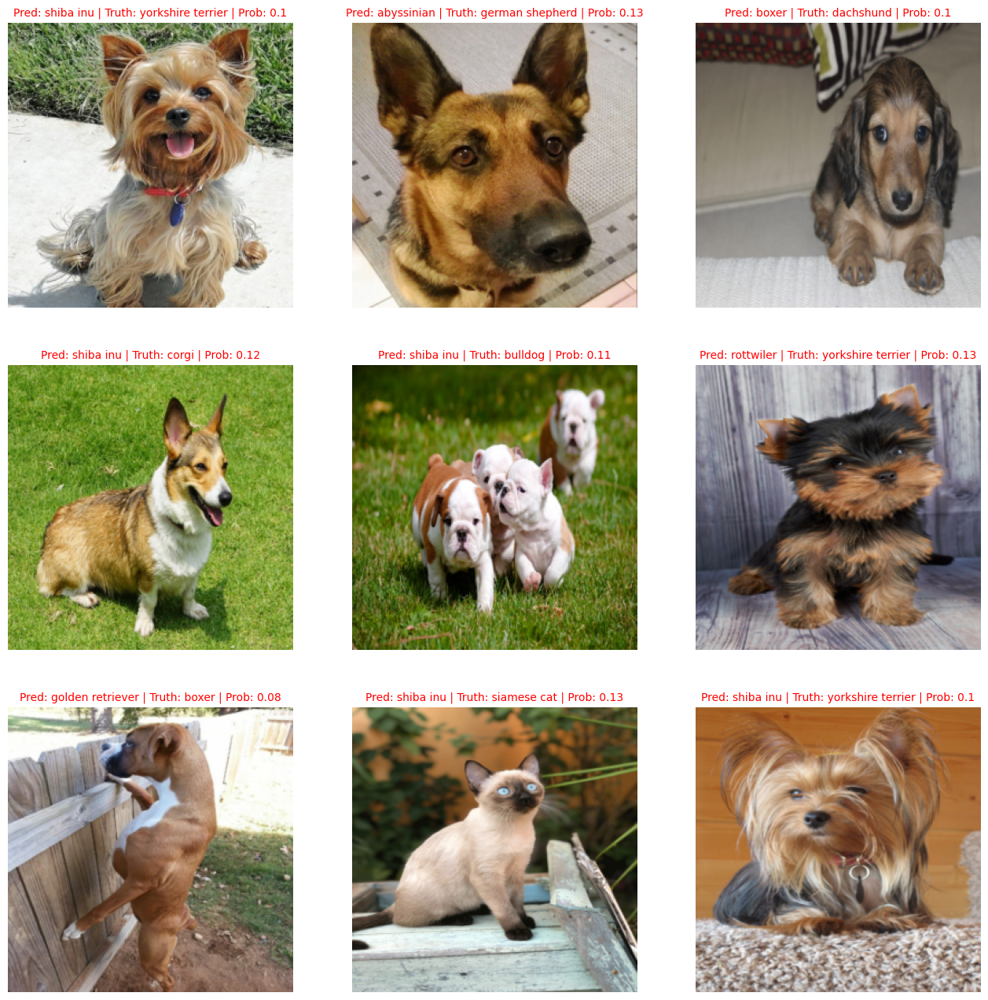

In [ ]:
# Predict and Plot some random images
pred_and_plot_image(model_0, test_data, 9)

In [ ]:
# Visualise performnace on tensorboard
%load_ext tensorboard
%tensorboard --logdir writer.log_dir

<IPython.core.display.Javascript object>

In [ ]:
# For loading
base_model_path = '/content/models/pet_breed_classifier_V0.pth'
model_0_loaded = AnimalBreedClassifierV0(input_shape = 3,
                                          hidden_units = 10,
                                          output_shape = len(class_names)).to(device)
model_0_loaded.load_state_dict(torch.load(base_model_path))

model_0_loaded

AnimalBreedClassifierV0(
  (block_1): Sequential(
    (0): Conv2d(3, 10, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): ReLU()
    (2): MaxPool2d(kernel_size=4, stride=4, padding=0, dilation=1, ceil_mode=False)
  )
  (block_2): Sequential(
    (0): Conv2d(10, 10, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): ReLU()
    (2): MaxPool2d(kernel_size=4, stride=4, padding=0, dilation=1, ceil_mode=False)
  )
  (fc_layer): Sequential(
    (0): Flatten(start_dim=1, end_dim=-1)
    (1): Linear(in_features=160, out_features=23, bias=True)
  )
)

In [ ]:
# Creating a custom function which depending on the pretrained model will create its custom dataclass and dataloaders

def get_model_and_dataloaders(model: str,
                       train_dir: str,
                       test_dir: str,
                       batch_size: int):

  # model's final fc layer is torch.nn.Linear with 2048 in features and 1000 put_features (change it to 23 for our purpose)
  if model == 'InceptionNet':
    # Get Weights (pretrained)
    weights = torchvision.models.Inception_V3_Weights.DEFAULT
    # Get the model with the pre_trained weights
    model = torchvision.models.inception_v3(weights = weights)
    # Get Transforms
    model_transforms = weights.transforms()
    # Create  Custom Dataset by subclassing ImageFolder and Dataloaders
    train_data = datasets.ImageFolder(train_data_path, transform = model_transforms)
    test_data = datasets.ImageFolder(test_data_path, transform = model_transforms)
    # Create Dataloader
    train_dataloader = DataLoader(dataset = train_data,
                                  batch_size = batch_size, # how many samples per batch?
                                  num_workers = 1, # how many subprocesses to use for data loading? (higher = more)
                                  shuffle = True) # shuffle the data?

    test_dataloader = DataLoader(dataset = test_data,
                                batch_size = batch_size,
                                num_workers = 1,
                                shuffle = False) # don't usually need to shuffle testing data
    # Freeze all layers to avoid training of pretrained weights except that of the last year
    for param in model.parameters():
      param.requires_grad = False
    # Modify Model's FC layer
    model.fc = nn.Linear(in_features = 2048, out_features = len(train_data.classes))
    # Remove AuxLogits Layer which also returns a (1000,) output hence getting two outputs using the forward pass
    model.AuxLogits = None
    # Return model and dataloaders
    return model.to(device), train_dataloader, test_dataloader
#####################################################################################################################################

  # ResNet50 chosen. Uses input size of N x 3 x 224 x 224. Same modification as Inception
  elif model == 'ResNet':
    # Get Weights (pretrained)
    weights = torchvision.models.ResNet50_Weights.DEFAULT
    # Get the model with the pre_trained weights
    model = torchvision.models.resnet50(weights = weights)
    # Get Transforms
    model_transforms = weights.transforms()
    # Create  Custom Dataset by subclassing ImageFolder and Dataloaders
    train_data = datasets.ImageFolder(train_data_path, transform = model_transforms)
    test_data = datasets.ImageFolder(test_data_path, transform = model_transforms)
    # Create Dataloader
    train_dataloader = DataLoader(dataset = train_data,
                                  batch_size = batch_size, # how many samples per batch?
                                  num_workers = 1, # how many subprocesses to use for data loading? (higher = more)
                                  shuffle = True) # shuffle the data?

    test_dataloader = DataLoader(dataset = test_data,
                                batch_size = batch_size,
                                num_workers = 1,
                                shuffle = False) # don't usually need to shuffle testing data
    # Freeze all layers to avoid training of pretrained weights except that of the last year
    for param in model.parameters():
      param.requires_grad = False
    # Modify Model's FC layer
    model.fc = nn.Linear(in_features = 2048, out_features = len(train_data.classes))
    model.AuxLogits = None
    # Return model and dataloaders
    return model.to(device), train_dataloader, test_dataloader

#####################################################################################################################################

  #EfficientNet_v2_l chosen. Expects input size of N x 3 x 224 x 224. This time the Last FC layer has in features 1280 (unchanged) and out features as 1000 (change to 3)
  elif model == 'EfficientNet':
    # Get Weights (pretrained)
    weights = torchvision.models.EfficientNet_V2_L_Weights.DEFAULT
    # Get the model with the pre_trained weights
    model = torchvision.models.efficientnet_v2_l(weights = weights)
    # Get Transforms
    model_transforms = weights.transforms()
    # Create  Custom Dataset by subclassing ImageFolder and Dataloaders
    train_data = datasets.ImageFolder(train_data_path, transform = model_transforms)
    test_data = datasets.ImageFolder(test_data_path, transform = model_transforms)
    # Create Dataloader
    train_dataloader = DataLoader(dataset = train_data,
                                  batch_size = batch_size, # how many samples per batch?
                                  num_workers = 1, # how many subprocesses to use for data loading? (higher = more)
                                  shuffle = True) # shuffle the data?

    test_dataloader = DataLoader(dataset = test_data,
                                batch_size = batch_size,
                                num_workers = 1,
                                shuffle = False) # don't usually need to shuffle testing data
    # Freeze all layers to avoid training of pretrained weights except that of the last year
    for param in model.parameters():
      param.requires_grad = False
    # Modify Model's classifier layer
    model.classifier = nn.Sequential(nn.Dropout(p = 0.4, inplace = True),
          nn.Linear(in_features=1280, out_features = len(train_data.classes), bias = True)
    )
    # Return model and dataloaders
    return model.to(device), train_dataloader, test_dataloader

#####################################################################################################################################

  # Chosen MobileNet_V3_Small. Expects Input of size N x 3 x 224 x 224. This time the final FC layer consists of the following:
  # (classifier): Sequential(
  #  (0): Linear(in_features=576, out_features=1024, bias=True) --> unchanged
  #  (1): Hardswish()                                           --> unchaned
  #  (2): Dropout(p=0.2, inplace=True)                          --> unchanged
  #  (3): Linear(in_features=1024, out_features=1000, bias=True) --> changed to Linear(in_features=1024, out_features=23, bias=True)
  # )
  elif model == 'MobileNet':
    # Get Weights (pretrained)
    weights = torchvision.models.MobileNet_V3_Small_Weights.DEFAULT
    # Get the model with the pre_trained weights
    model = torchvision.models.mobilenet_v3_small(weights = weights)
    # Get Transforms
    model_transforms = weights.transforms()
    # Create  Custom Dataset by subclassing ImageFolder and Dataloaders
    train_data = datasets.ImageFolder(train_data_path, transform = model_transforms)
    test_data = datasets.ImageFolder(test_data_path, transform = model_transforms)
    # Create Dataloader
    train_dataloader = DataLoader(dataset = train_data,
                                  batch_size = batch_size, # how many samples per batch?
                                  num_workers = 1, # how many subprocesses to use for data loading? (higher = more)
                                  shuffle = True) # shuffle the data?

    test_dataloader = DataLoader(dataset = test_data,
                                batch_size = batch_size,
                                num_workers = 1,
                                shuffle = False) # don't usually need to shuffle testing data
    # Freeze all layers to avoid training of pretrained weights except that of the last year
    for param in model.parameters():
      param.requires_grad = False
    # Modify Model's FC layer
    model.classifier = nn.Sequential(
        nn.Linear(in_features = 576, out_features = 1024),
        nn.Hardswish(),
        nn.Dropout(p = 0.2, inplace = True),
        nn.Linear(in_features = 1024, out_features = len(train_data.classes))
    )

    # Return model and dataloaders
    return model.to(device), train_dataloader, test_dataloader

#####################################################################################################################################

In [ ]:
# Get Pretrained Models
model_1, train_dataloader_1, test_dataloader_1 = get_model_and_dataloaders('InceptionNet', train_data_path, test_data_path, 32)
model_2, train_dataloader_2, test_dataloader_2 = get_model_and_dataloaders('ResNet', train_data_path, test_data_path, 32)
model_3, train_dataloader_3, test_dataloader_3 = get_model_and_dataloaders('EfficientNet', train_data_path, test_data_path, 32)
model_4, train_dataloader_4, test_dataloader_4 = get_model_and_dataloaders('MobileNet', train_data_path, test_data_path, 32)

Downloading: "https://download.pytorch.org/models/inception_v3_google-0cc3c7bd.pth" to /root/.cache/torch/hub/checkpoints/inception_v3_google-0cc3c7bd.pth
100%|██████████| 104M/104M [00:01<00:00, 84.0MB/s] 
Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:01<00:00, 83.2MB/s]
Downloading: "https://download.pytorch.org/models/efficientnet_v2_l-59c71312.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_v2_l-59c71312.pth
100%|██████████| 455M/455M [00:05<00:00, 81.9MB/s]
Downloading: "https://download.pytorch.org/models/mobilenet_v3_small-047dcff4.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v3_small-047dcff4.pth
100%|██████████| 9.83M/9.83M [00:00<00:00, 80.6MB/s]


In [ ]:
# Training + Evaluating + Saving each of the models

from py_scripts import train_eval_save_func

writer = utils.create_writer(experiment_name = "pet_breed_80_20_split",
                      model_name = "InceptionNet_V3",
                      extra = "5_epochs")

print('ResNet Loop.........................\n')

writer = utils.create_writer(experiment_name = "pet_breed_80_20_split",
                      model_name = "ResNet_50",
                      extra = "5_epochs")

model_2_results = train_eval_save_func.train_eval_save(model = model_2,
                train_dataloader = train_dataloader_2,
                test_dataloader = test_dataloader_2,
                loss_fn = loss_fn,
                optimizer = optimizer,
                epochs = 3,
                num_classes = len(class_names),
                device = device,
                writer = writer,
                target_dir = '/content/models',
                model_name = 'resnet_pet_breed_V2.pth')

print(f'ResNet Results: {model_2_results}')

# Visualizing performance using Tensorboard
%load_ext tensorboard
%tensorboard --logdir writer.log_dir

[INFO] Created SummaryWriter, saving to: /content/model_runs/2023-07-15/pet_breed_80_20_split/InceptionNet_V3/5_epochs...
ResNet Loop.........................

[INFO] Created SummaryWriter, saving to: /content/model_runs/2023-07-15/pet_breed_80_20_split/ResNet_50/5_epochs...


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 3.1420 | train_acc: 0.0416 | train_precision: 0.0292 | train_recall: 0.0367 | train_f1: 0.0281 | test_loss: 3.1302 | test_acc: 0.0525 | test_acc: 0.0525 | test_precision: 0.0510 | test_recall: 0.0086 | test_f1: 0.0134 | 
Epoch: 2 | train_loss: 3.1416 | train_acc: 0.0422 | train_precision: 0.0273 | train_recall: 0.0350 | train_f1: 0.0269 | test_loss: 3.1303 | test_acc: 0.0550 | test_acc: 0.0550 | test_precision: 0.0464 | test_recall: 0.0089 | test_f1: 0.0135 | 
Epoch: 3 | train_loss: 3.1398 | train_acc: 0.0441 | train_precision: 0.0299 | train_recall: 0.0394 | train_f1: 0.0298 | test_loss: 3.1287 | test_acc: 0.0563 | test_acc: 0.0563 | test_precision: 0.0534 | test_recall: 0.0088 | test_f1: 0.0137 | 

Train Time: 446.502 seconds


TypeError: ignored

In [ ]:
# evaluate model
model_2_results = engine.eval_model(model = model_2,
                              data_loader = test_dataloader_2,
                              loss_fn = loss_fn,
                              num_classes = len(class_names),
                              device = device,
                              inception = False)
# save model
utils.save_model(model = model_2,
                 target_dir = '/content/models',
                 model_name = 'resnet_pet_breed_V2.pth')
print(model_2_results)

[INFO] Saving model to: /content/models/resnet_pet_breed_V2.pth
{'model_name': 'ResNet', 'model_loss': 3.128681182861328, 'model_accuracy': 0.05625, 'model_precision': 0.053449550449550444, 'model_recall': 0.008812438337611608, 'model_f1': 0.0}


In [ ]:
print('EfficientNet Loop.........................\n')

writer = utils.create_writer(experiment_name = "pet_breed_80_20_split",
                      model_name = "EfficientNet_V2_L",
                      extra = "5_epochs")

model_3_results = train_eval_save_func.train_eval_save(model = model_3,
                train_dataloader = train_dataloader_3,
                test_dataloader = test_dataloader_3,
                loss_fn = loss_fn,
                optimizer = optimizer,
                epochs = 3,
                num_classes = len(class_names),
                device = device,
                writer = writer,
                target_dir = '/content/models',
                model_name = 'efficientnet_pet_breed_V3.pth')

print(f'EfficientNet Results: {model_3_results}')

# Visualizing performance using Tensorboard
%load_ext tensorboard
%tensorboard --logdir writer.log_dir

EfficientNet Loop.........................

[INFO] Created SummaryWriter, saving to: /content/model_runs/2023-07-15/pet_breed_80_20_split/EfficientNet_V2_L/5_epochs...


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 3.3126 | train_acc: 0.0361 | train_precision: 0.0218 | train_recall: 0.0312 | train_f1: 0.0222 | test_loss: 3.2429 | test_acc: 0.0250 | test_acc: 0.0250 | test_precision: 0.0205 | test_recall: 0.0034 | test_f1: 0.0054 | 
Epoch: 2 | train_loss: 3.3104 | train_acc: 0.0383 | train_precision: 0.0245 | train_recall: 0.0314 | train_f1: 0.0229 | test_loss: 3.2468 | test_acc: 0.0275 | test_acc: 0.0275 | test_precision: 0.0261 | test_recall: 0.0038 | test_f1: 0.0061 | 
Epoch: 3 | train_loss: 3.2956 | train_acc: 0.0358 | train_precision: 0.0209 | train_recall: 0.0317 | train_f1: 0.0212 | test_loss: 3.2434 | test_acc: 0.0250 | test_acc: 0.0250 | test_precision: 0.0218 | test_recall: 0.0033 | test_f1: 0.0052 | 

Train Time: 876.862 seconds


TypeError: ignored

In [ ]:
# evaluate model
model_3_results = engine.eval_model(model = model_3,
                              data_loader = test_dataloader_3,
                              loss_fn = loss_fn,
                              num_classes = len(class_names),
                              device = device,
                              inception = False)
# save model
utils.save_model(model = model_3,
                 target_dir = '/content/models',
                 model_name = 'efficientnet_pet_breed_V3.pth')
print(model_3_results)

[INFO] Saving model to: /content/models/efficientnet_pet_breed_V3.pth
{'model_name': 'EfficientNet', 'model_loss': 3.2433571815490723, 'model_accuracy': 0.025, 'model_precision': 0.021847001483365117, 'model_recall': 0.003323293959217713, 'model_f1': 0.0}


In [ ]:
print('MobileNet Loop.........................\n')

writer = utils.create_writer(experiment_name = "pet_breed_80_20_split",
                      model_name = "MobileNet_V3_S",
                      extra = "5_epochs")

model_4_results = train_eval_save_func.train_eval_save(model = model_4,
                train_dataloader = train_dataloader_4,
                test_dataloader = test_dataloader_4,
                loss_fn = loss_fn,
                optimizer = optimizer,
                epochs = 3,
                num_classes = len(class_names),
                device = device,
                writer = writer,
                target_dir = '/content/models',
                model_name = 'mobilenet_pet_breed_V4.pth')

print(f'MobileNet Results: {model_4_results}')

# Visualizing performance using Tensorboard
%load_ext tensorboard
%tensorboard --logdir writer.log_dir

MobileNet Loop.........................

[INFO] Created SummaryWriter, saving to: /content/model_runs/2023-07-15/pet_breed_80_20_split/MobileNet_V3_S/5_epochs...


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 3.1414 | train_acc: 0.0435 | train_precision: 0.0281 | train_recall: 0.0394 | train_f1: 0.0267 | test_loss: 3.1413 | test_acc: 0.0450 | test_acc: 0.0450 | test_precision: 0.0460 | test_recall: 0.0085 | test_f1: 0.0135 | 
Epoch: 2 | train_loss: 3.1410 | train_acc: 0.0435 | train_precision: 0.0267 | train_recall: 0.0369 | train_f1: 0.0248 | test_loss: 3.1384 | test_acc: 0.0475 | test_acc: 0.0475 | test_precision: 0.0457 | test_recall: 0.0082 | test_f1: 0.0125 | 
Epoch: 3 | train_loss: 3.1398 | train_acc: 0.0470 | train_precision: 0.0297 | train_recall: 0.0375 | train_f1: 0.0275 | test_loss: 3.1375 | test_acc: 0.0512 | test_acc: 0.0512 | test_precision: 0.0492 | test_recall: 0.0082 | test_f1: 0.0129 | 

Train Time: 454.626 seconds


TypeError: ignored

In [ ]:
# evaluate model
model_4_results = engine.eval_model(model = model_4,
                              data_loader = test_dataloader_4,
                              loss_fn = loss_fn,
                              num_classes = len(class_names),
                              device = device,
                              inception = False)
# save model
utils.save_model(model = model_4,
                 target_dir = '/content/models',
                 model_name = 'mobilenet_pet_breed_V4.pth')
print(model_4_results)

[INFO] Saving model to: /content/models/mobilenet_pet_breed_V4.pth
{'model_name': 'MobileNetV3', 'model_loss': 3.137526273727417, 'model_accuracy': 0.05125, 'model_precision': 0.04921416361416361, 'model_recall': 0.008164552540525843, 'model_f1': 0.0}


In [ ]:
writer = utils.create_writer(experiment_name = "pet_breed_80_20_split",
                      model_name = "InceptionNet_V3",
                      extra = "5_epochs")

print('InceptionNet Loop.........................\n')


engine.train(model = model_1,
              train_dataloader = train_dataloader_1,
              test_dataloader = test_dataloader_1,
              optimizer = optimizer,
              loss_fn = loss_fn,
              num_classes = len(class_names),
              epochs = EPOCHS,
              device = device,
              writer = writer,
              inception = True)

# Evaluate the model and store results
model_1_results = engine.eval_model(model = model_1,
                            data_loader = test_dataloader_1,
                            loss_fn = loss_fn,
                            num_classes = len(class_names),
                            device = device,
                            inception = True)

# Save Model b
utils.save_model(model = model_1,
                target_dir = '/content/models',
                model_name = 'inception_pet_breed_V1.pth')

# Print Results
print(model_1_results)

# Visualizing performance using Tensorboard
%load_ext tensorboard
%tensorboard --logdir writer.log_dir

[INFO] Created SummaryWriter, saving to: /content/model_runs/2023-07-15/pet_breed_80_20_split/InceptionNet_V3/5_epochs...
InceptionNet Loop.........................



  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 3.1808 | train_acc: 0.0416 | train_precision: 0.0266 | train_recall: 0.0322 | train_f1: 0.0249 | test_loss: 3.1652 | test_acc: 0.0437 | test_acc: 0.0437 | test_precision: 0.0345 | test_recall: 0.0143 | test_f1: 0.0137 | 
Epoch: 2 | train_loss: 3.1814 | train_acc: 0.0406 | train_precision: 0.0261 | train_recall: 0.0332 | train_f1: 0.0251 | test_loss: 3.1660 | test_acc: 0.0387 | test_acc: 0.0387 | test_precision: 0.0304 | test_recall: 0.0133 | test_f1: 0.0131 | 
Epoch: 3 | train_loss: 3.1741 | train_acc: 0.0416 | train_precision: 0.0286 | train_recall: 0.0350 | train_f1: 0.0272 | test_loss: 3.1653 | test_acc: 0.0450 | test_acc: 0.0450 | test_precision: 0.0384 | test_recall: 0.0137 | test_f1: 0.0138 | 
Epoch: 4 | train_loss: 3.1829 | train_acc: 0.0435 | train_precision: 0.0295 | train_recall: 0.0365 | train_f1: 0.0282 | test_loss: 3.1663 | test_acc: 0.0413 | test_acc: 0.0413 | test_precision: 0.0345 | test_recall: 0.0128 | test_f1: 0.0127 | 
Epoch: 5 | train_loss: 3

<IPython.core.display.Javascript object>

Total Time taken to perform inference on 9 images: 0.146 seconds
Average Time taken to perform inference per image: 0.016 seconds
--------------------------------------------------
Total Time taken to perform inference on 9 images: 0.085 seconds
Average Time taken to perform inference per image: 0.009 seconds
--------------------------------------------------
Total Time taken to perform inference on 9 images: 0.378 seconds
Average Time taken to perform inference per image: 0.042 seconds
--------------------------------------------------
Total Time taken to perform inference on 9 images: 0.092 seconds
Average Time taken to perform inference per image: 0.010 seconds


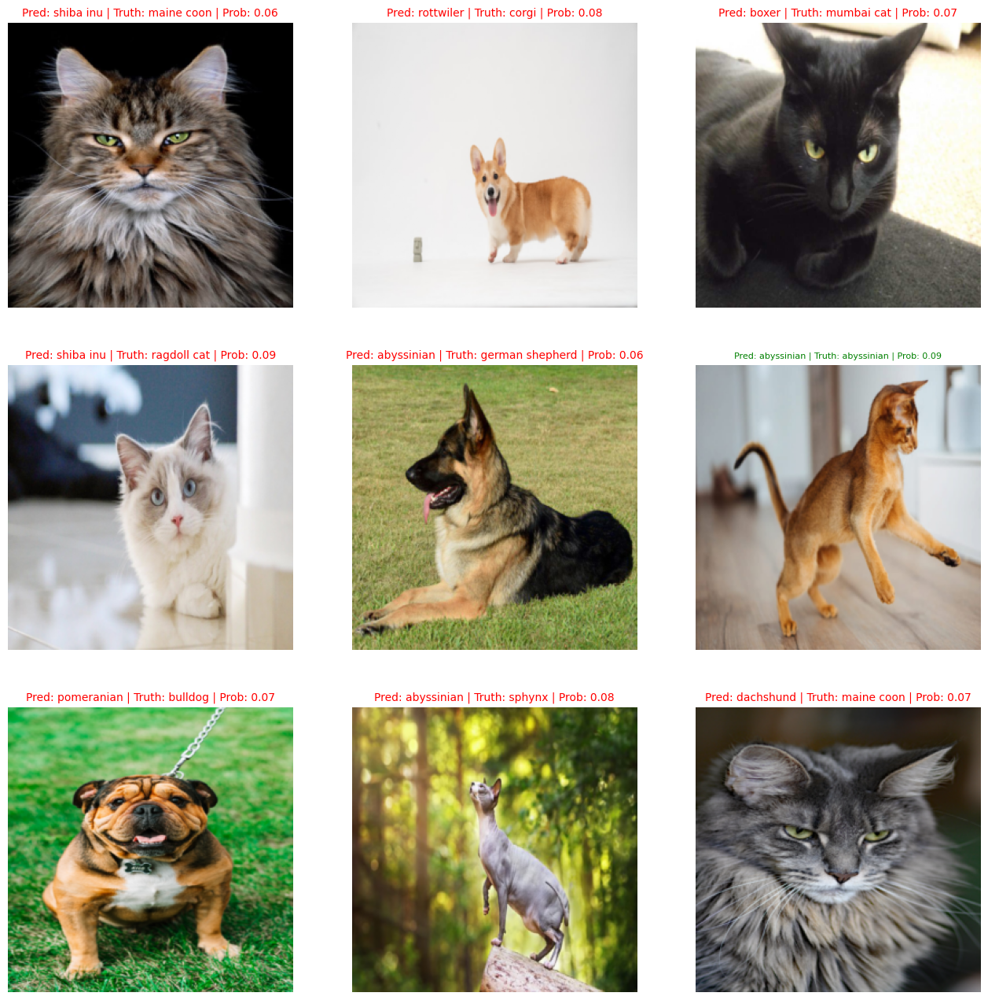

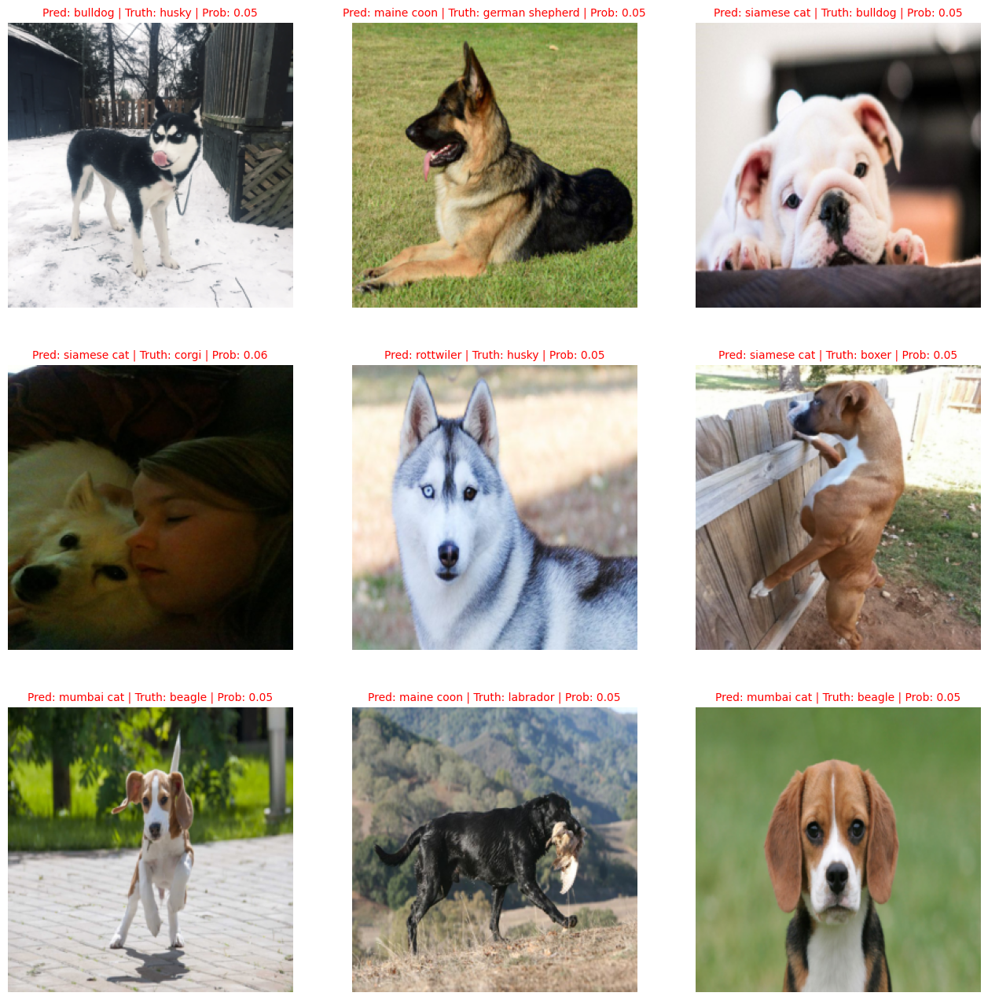

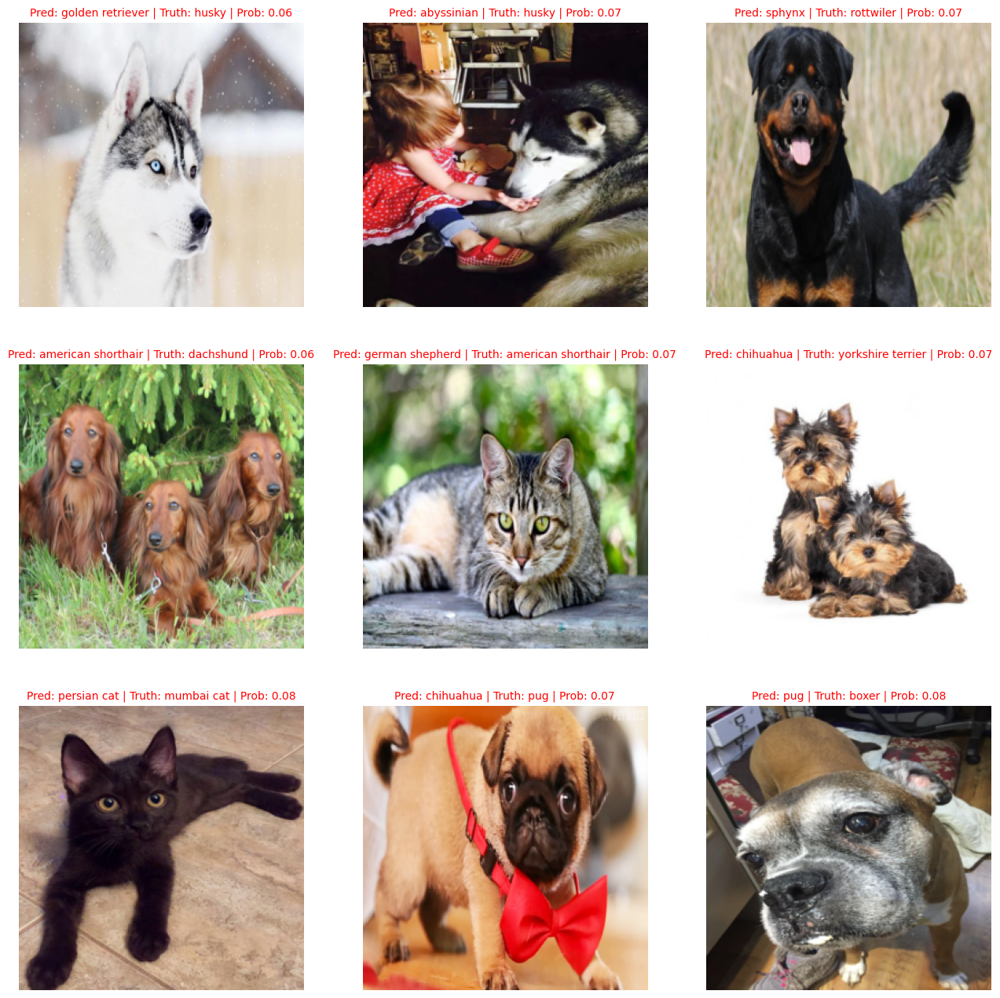

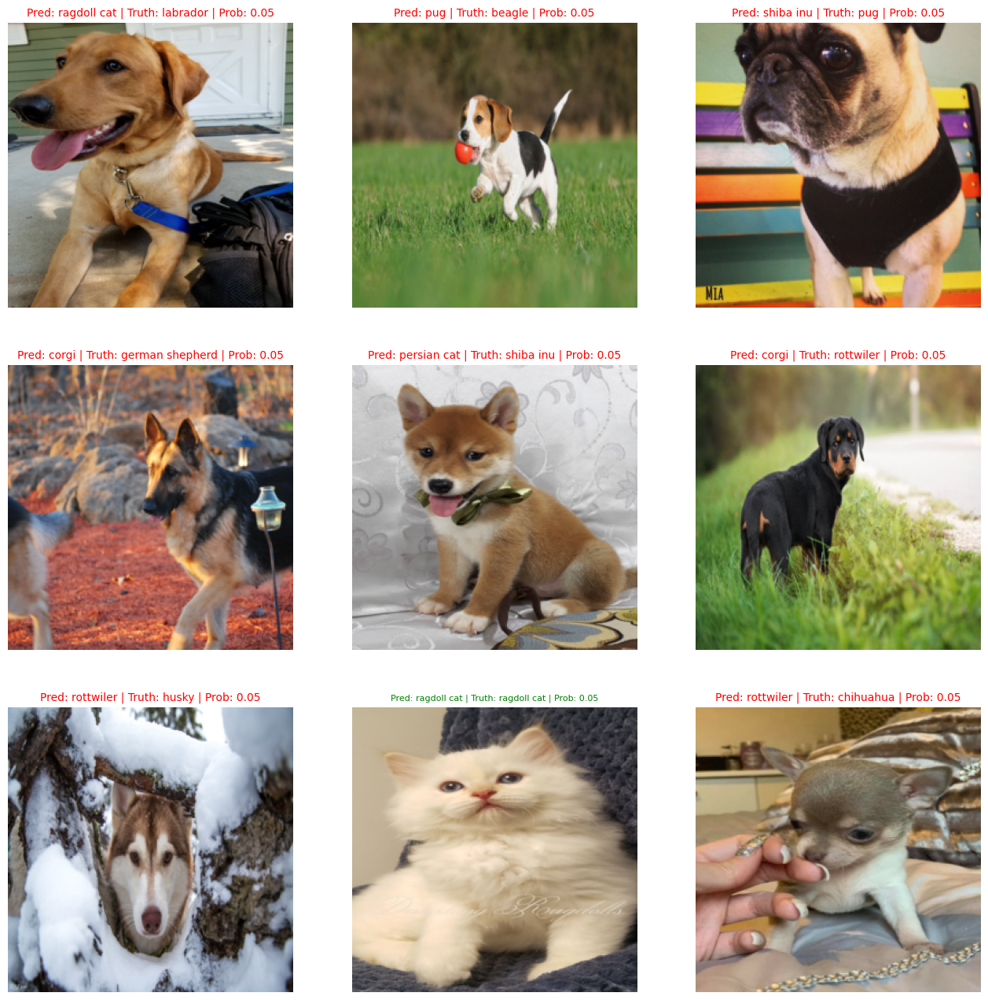

In [ ]:
# Predict and Plot some random images using each of the models
pred_and_plot_image(model_1, test_data, 9)
print('-'*50)
pred_and_plot_image(model_2, test_data, 9)
print('-'*50)
pred_and_plot_image(model_3, test_data, 9)
print('-'*50)
pred_and_plot_image(model_4, test_data, 9)